Visualization of scGen manifolds (cells + nuclei, all regions/Atria/Ventricles)
<br>
Eric Lindberg, MDC Berlin
<br>
Date: 2020 07 20
<br>
eric.lindberg@mdc-berlin.de 

# Libraries

In [1]:
import os
import bbknn
import anndata
import logging
import numpy as np
import pandas as pd
from datetime import timedelta, datetime
import scanpy.api as sc
#import diffxpy as de
import seaborn as sns
import matplotlib.pyplot as plt
#import rpy2
#import leidenalg
import csv
from pandas import Timestamp
import re
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import rankdata 
import scipy

/home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning,


In [13]:
sc.settings.verbosity =3
sc.logging.print_version_and_date()
sc.settings.set_figure_params(dpi=800, color_map='RdBu_r')
logging.getLogger("tensorflow").setLevel(logging.ERROR)
logging.getLogger("batchglm").setLevel(logging.INFO)
logging.getLogger("diffxpy").setLevel(logging.INFO)

Running Scanpy 1.4.6, on 2020-06-10 12:03.


In [3]:
random_state=10

In [4]:
path_out="/fast/AG_Huebner/huebner3/ANALYSES/20191112_cs_HH_England/scanpy/20200423/FB"

# Functions

In [5]:
def makevector_topmarkers(anndata, top_n, ldFC_cutoff=0.5, pvals_adj_cutoff=10**-30): 
    results=anndata.uns['rank_genes_groups']
    clusters = results['names'].dtype.names
    top_genes=[]
    for cluster in clusters:
        topgenes_cluster=results['names'][cluster][np.where((results['logfoldchanges'][cluster]>=ldFC_cutoff) & (results['pvals_adj'][cluster]<(pvals_adj_cutoff)))][0:top_n]
        top_genes.extend(topgenes_cluster)
    return(top_genes)

## Analysis from scGen

In [6]:
#scgen_corrected=sc.read_h5ad(path_out + "/ALL_corrected_FB_ATV_double_LEIDEN.h5ad")

In [7]:
#scgen_corrected_raw=sc.read_h5ad(path_out + "/ALL_corrected_FB_ATV_double_RAW.h5ad")

In [ ]:
# This is the object after scGen correction
scgen_corrected=sc.read_h5ad(path_out + "/ALL_corrected_FB_ATV_double.h5ad") 
sc.pp.neighbors(scgen_corrected, random_state = random_state, n_neighbors=50)
sc.tl.umap(scgen_corrected, min_dist = 0.5, spread = 2, random_state = random_state) 

computing neighbors
    using 'X_pca' with n_pcs = 50


/home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../../home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../..

In [ ]:
sc.tl.leiden(scgen_corrected, resolution = 0.6, random_state = random_state)

In [ ]:
# assign clusters after checking DEgenes
scgen_corrected.obs["cell_states"]=scgen_corrected.obs["leiden"]
subs = {
    "0":"FB1",
    "1":"FB2",
    "2":"FB3",
    "3":"FB4",
    "4":"FB5",
    "5":"FB6",
    "6":"FB7",
    "7":"FB1", # This cluster is small and shows a lot of genes with low score
    "8":"FB1", # This cluster is small and shows a lot of genes with low score
     }

In [9]:
# Append description to cluster name
scgen_corrected.obs['cell_states_long']=scgen_corrected.obs['cell_states']
subs = {
    "FB1":"FB1_VT-canonical",
    "FB2":"FB2_AT-canonical",
    "FB3":"FB3_MP-interacting",
    "FB4":"FB4_ECM-producing",
    "FB5":"FB5_ECM-organising",
    "FB6":"FB6_Stromal",
    "FB7":"FB7_CM-like",
     }
#rev_subs = { v:k for k,v in subs.items()}
x=[subs.get(item,item)  for item in scgen_corrected.obs['cell_states_long']]
scgen_corrected.obs['cell_states_long']=x
pd.value_counts(scgen_corrected.obs['cell_states_long'])

FB1_VT-canonical      26632
FB2_AT-canonical      13779
FB3_MP-interacting     7744
FB4_ECM-producing      6146
FB5_ECM-organising     2518
FB6_Stromal            1610
FB7_CM-like             912
Name: cell_states_long, dtype: int64

In [ ]:
# Plot markers used for RNAscope validation 
#sc.pl.dotplot(scgen_corrected, 
#           ['FAP', 'LINC01133'], 
#              groupby="cell_states", standard_scale="var")

In [ ]:
# Backup step
#scgen_corrected.write(path_out + "/ALL_corrected_FB_ATV_double_LEIDEN.h5ad")

In [7]:
scgen_corrected=sc.read_h5ad(path_out + "/ALL_corrected_FB_ATV_double_LEIDEN.h5ad")

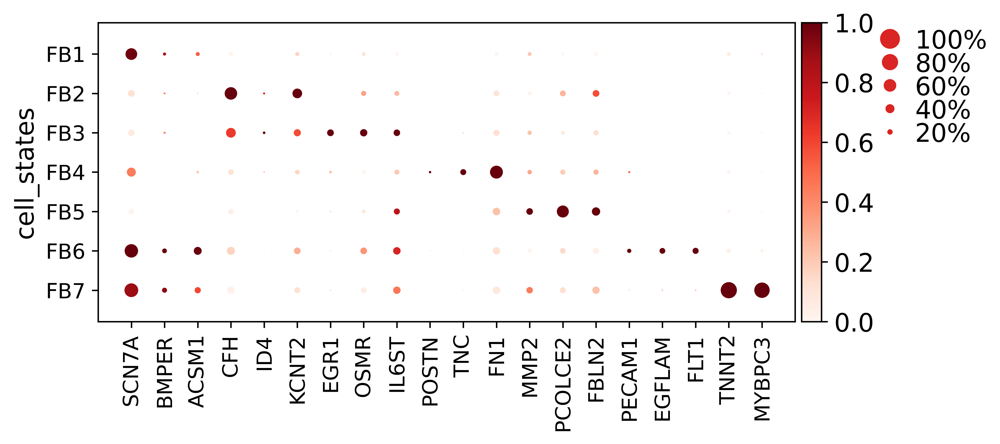

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[7.0, 0, 0.2, 0.5, 0.25])

In [20]:
# Plot top markers, which were used to assign function/pathway to the subclusters
sc.pl.dotplot(scgen_corrected, 
           ['SCN7A', 'BMPER', 'ACSM1', 
           "CFH", "ID4", "KCNT2", 
           "EGR1", "OSMR", "IL6ST", 
            "POSTN", "TNC", "FN1",
           "MMP2", "PCOLCE2", "FBLN2", 
           "PECAM1", "EGFLAM", "FLT1", 
           "TNNT2", "MYBPC3"], 
              groupby="cell_states", standard_scale="var", save="markergenes_FB_A.svg")

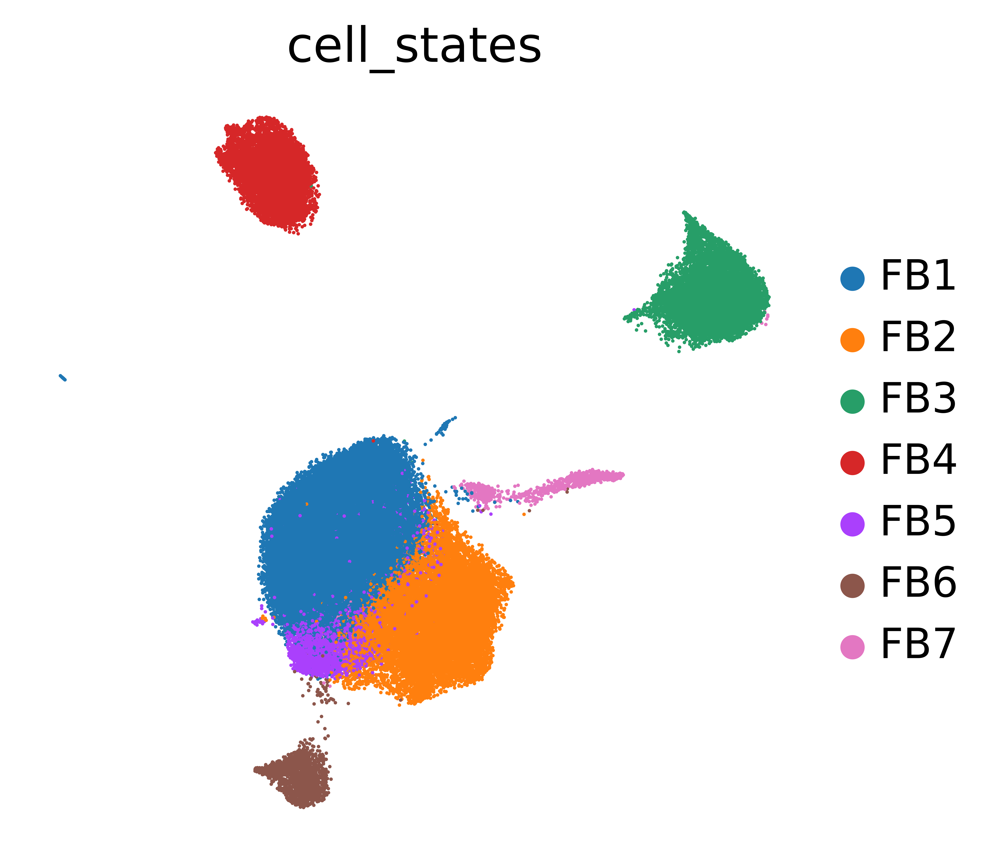

In [14]:
sc.pl.umap(scgen_corrected, 
           color=['cell_states'], 
           size = 4, legend_fontsize = 12, 
          legend_loc='right margin', frameon=False, 
          #save="uMAP_FB_ATV.svg")
           save="uMAP_FB_ATV_800_2.png")

In [ ]:
#scgen_corrected.write(path_out + "/ALL_corrected_FB_ATV_double_LEIDEN.h5ad")

In [10]:
scgen_corrected.X.shape

(59341, 8906)

In [12]:
scgen_corrected_raw.X.shape

(59341, 33538)

Save the object with atrial and ventricular fibroblasts for Cellxgene: 

In [17]:
scgen_corrected_raw.obs.index==scgen_corrected.obs.index

array([ True,  True,  True, ...,  True,  True,  True])

In [18]:
tmp=sc.AnnData(scgen_corrected_raw.X,
                  obs=scgen_corrected.obs,
                  var=scgen_corrected_raw.var,
                  obsm=scgen_corrected.obsm,
                 )

In [19]:
tmp.obs['cell_states_long']=tmp.obs['cell_states']
subs = {
    "FB1":"FB1_VT-canonical",
    "FB2":"FB2_AT-canonical",
    "FB3":"FB3_MP-interacting",
    "FB4":"FB4_ECM-producing",
    "FB5":"FB5_ECM-organising",
    "FB6":"FB6_Stromal",
    "FB7":"FB7_CM-like",
     }
#rev_subs = { v:k for k,v in subs.items()}
x=[subs.get(item,item)  for item in tmp.obs['cell_states_long']]
tmp.obs['cell_states_long']=x
pd.value_counts(tmp.obs['cell_states_long'])

FB1_VT-canonical      26632
FB2_AT-canonical      13779
FB3_MP-interacting     7744
FB4_ECM-producing      6146
FB5_ECM-organising     2518
FB6_Stromal            1610
FB7_CM-like             912
Name: cell_states_long, dtype: int64

In [25]:
#tmp.write(path_out + "/ALL_corrected_FB_ATV_double_GDRIVE_RAW.h5ad")

... storing 'cell_states_long' as categorical


In [43]:
#expression.to_csv(path_out + "/ALL_corrected_FB_ATV_double_MARKERGENES.csv")

In [44]:
#tmp.write(path_out + "/ALL_corrected_FB_ATV_double_GDRIVE.h5ad")

In [45]:
#tmp.obs.to_csv(path_out + "/ALL_corrected_FB_ATV_double_GDRIVE_META.csv")

Check regional distribution per cluster

In [33]:
def stacked_barplot(adata, xaxis, stack, xaxis_label, legend_label, shift_top=0.2, xaxis_rotation=0, figsize=(10,10)):
    tmp=pd.crosstab(adata.obs[xaxis],
                adata.obs[stack]).sum(axis=1)
    
    ax= pd.crosstab(adata.obs[xaxis], 
                    adata.obs[stack]).apply(lambda r: r/r.sum()*100, axis=1)
    ax_1 = ax.plot.bar(figsize=figsize,stacked=True, rot=0)

    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), title=legend_label, prop={'size': 15})
    plt.xlabel(xaxis_label,fontweight="bold", size=18)
    plt.ylabel('Percent Distribution',fontweight="bold", size=18)
    
    for xaxistick in range(ax.shape[0]):
        ax_1.text(xaxistick-shift_top,110,tmp[xaxistick],va='center', rotation=45, fontsize=14.5, weight='bold')
    
    plt.xticks(rotation=xaxis_rotation, size=18)
    plt.yticks(rotation=xaxis_rotation, size=18)
    
    ax_1.grid(False)
    plt.show()

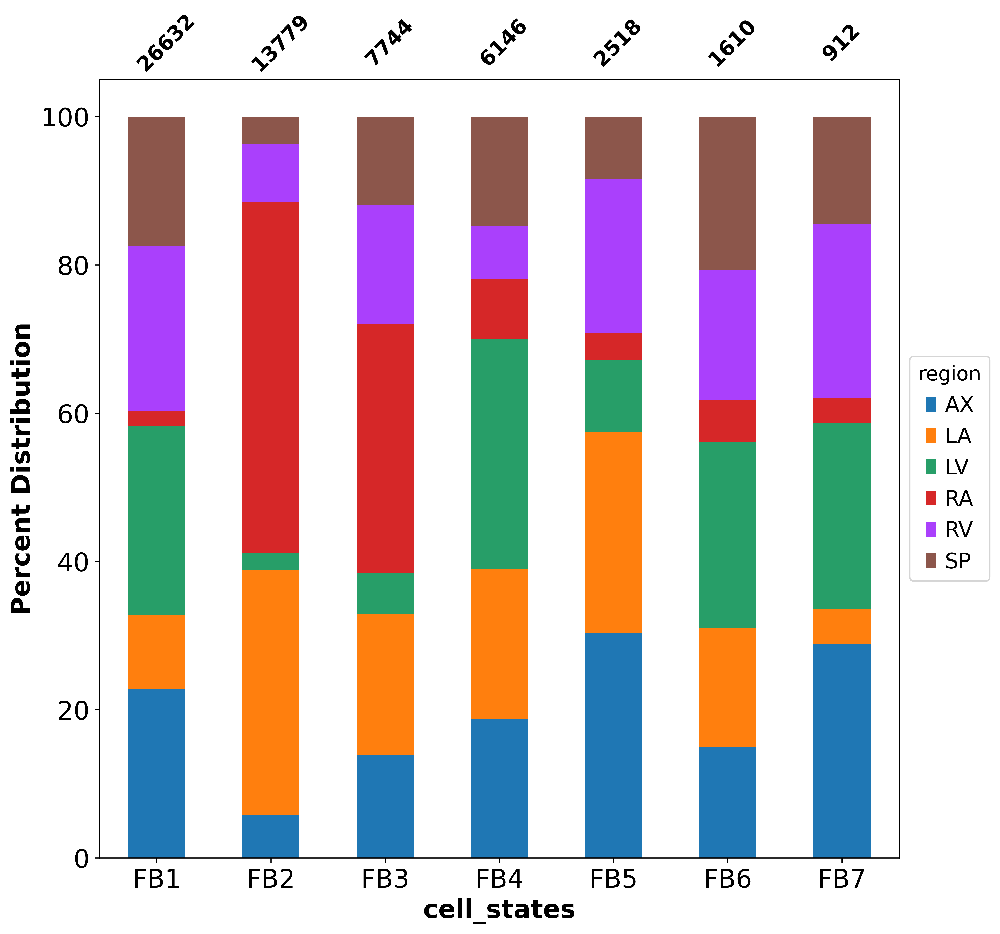

In [34]:
stacked_barplot(scgen_corrected, 'cell_states', 'region', "cell_states", "region")

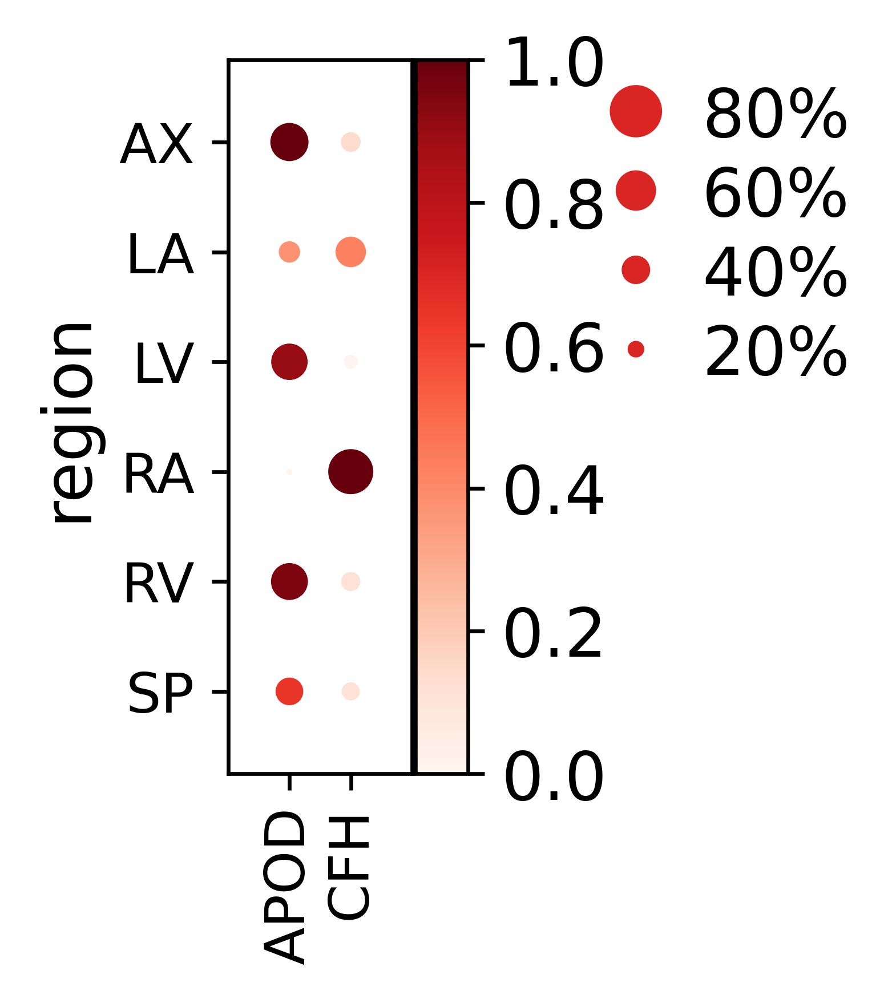

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[0.7, 0, 0.2, 0.5, 0.25])

In [39]:
# Markers for differentiating atrial vs. ventricular fibroblasts
sc.pl.dotplot(scgen_corrected,
              ['APOD', 'CFH'],
              groupby='region', use_raw=True, dendrogram=False, standard_scale="var",
              save="DOTPLOT_APODCFH.svg")

### Check enrichment of OSM pathway genes in clusters

In [40]:
scgen_corrected_raw=sc.read_h5ad(path_out + "/ALL_corrected_FB_ATV_double_RAW.h5ad")

In [42]:
scgen_corrected_raw.obs['cell_states']=scgen_corrected.obs['cell_states']

In [54]:
# The list of genes was collected manually from multiple published articles (cited in paper)
OSMp_genes=pd.read_csv("/fast/AG_Huebner/huebner3/ANALYSES/20191112_cs_HH_England/scanpy/20200423/FB/figures-htmls/Genetable_OSMp.tsv", sep="\t",
                      header=None)
OSMp_genes=OSMp_genes.iloc[:,0].values.tolist()

In [55]:
sc.pp.normalize_per_cell(scgen_corrected_raw, counts_per_cell_after=1e4)

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [56]:
sc.pp.log1p(scgen_corrected_raw)
sc.pp.scale(scgen_corrected_raw)

In [57]:
sc.tl.score_genes(scgen_corrected_raw, OSMp_genes, random_state=random_state, score_name="OSM_pathway_score")

computing score 'OSM_pathway_score'
    finished: added
    'OSM_pathway_score', score of gene set (adata.obs) (0:00:13)


Text(0, 0.5, 'Density')

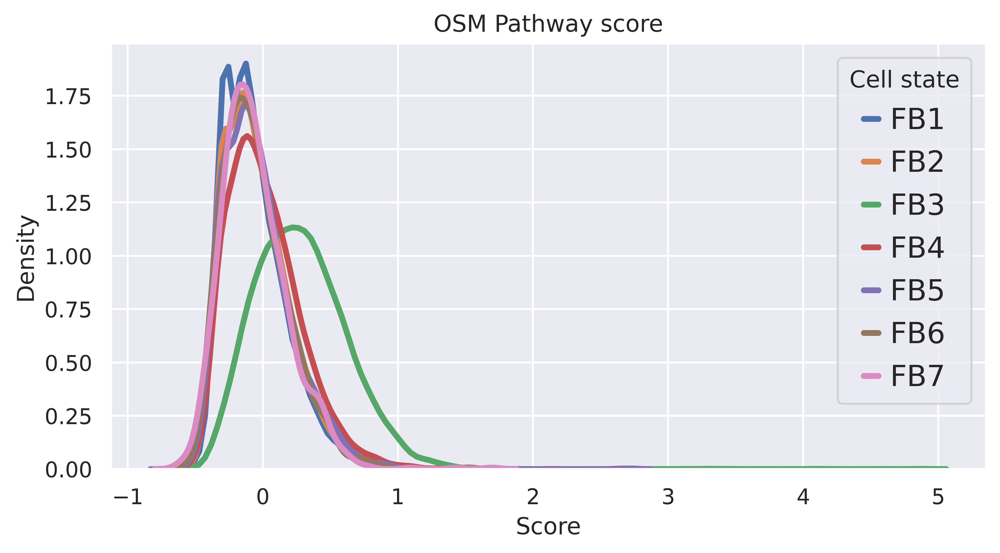

In [78]:
for cell_state in sorted(scgen_corrected_raw.obs['cell_states'].unique()):
    # Subset to the airline
    subset = scgen_corrected_raw[scgen_corrected_raw.obs['cell_states'] == cell_state]
    
    sns.set(rc={'figure.figsize':(8,4)})
    # Draw the density plot
    sns.distplot(subset.obs['OSM_pathway_score'], hist = False, kde = True,
                 kde_kws = {'linewidth': 3},
                 label = cell_state)
    
# Plot formatting
plt.legend(prop={'size': 15}, title = 'Cell state')
plt.title('OSM Pathway score')
plt.xlabel('Score')
plt.ylabel('Density')

### scGen normalisation of atrial FB clustering 

In [6]:
scgen_corrected_AT=sc.read_h5ad(path_out + "/ALL_corrected_FB_AT_double.h5ad")

In [7]:
sc.pp.neighbors(scgen_corrected_AT, random_state = random_state, n_neighbors=50) # vorher 40
sc.tl.umap(scgen_corrected_AT, min_dist = 0.1, spread = 1, random_state = random_state)

computing neighbors
    using 'X_pca' with n_pcs = 50


/home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../../home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../..

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:25)
computing UMAP


/home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:36)


In [8]:
sc.tl.leiden(scgen_corrected_AT, resolution = 0.6, random_state = random_state)

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:32)


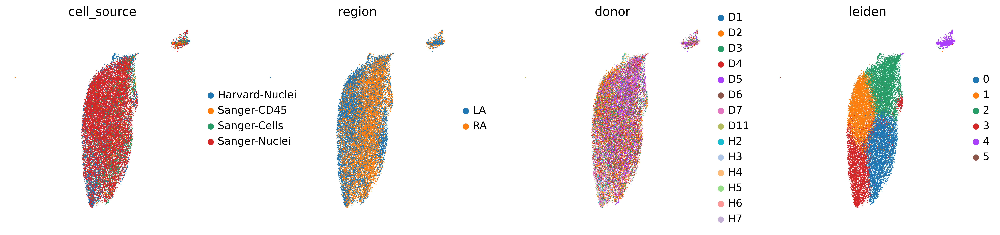

In [9]:
sc.pl.umap(scgen_corrected_AT, 
           color=['cell_source', 'region', 'donor', 'leiden'], 
           size = 4, legend_fontsize = 12, #color_map = 'RdPu',
#          palette=["#0066CC", "#CC0000", "#FF6600", "#9933CC", "#006633", "#993300", "#FF6699"], 
          legend_loc='right margin', frameon=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:59)


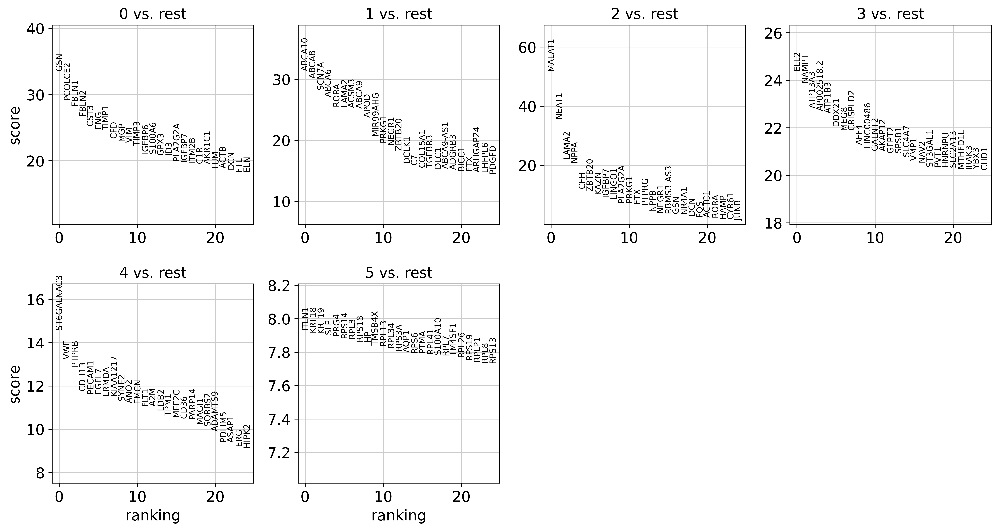

In [10]:
sc.tl.rank_genes_groups(scgen_corrected_AT, 'leiden', method='wilcoxon') # "leiden"
sc.pl.rank_genes_groups(scgen_corrected_AT, n_genes=25, sharey=False)

In [16]:
result = scgen_corrected_AT.uns['rank_genes_groups']
groups = result['names'].dtype.names
expression_AT=pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

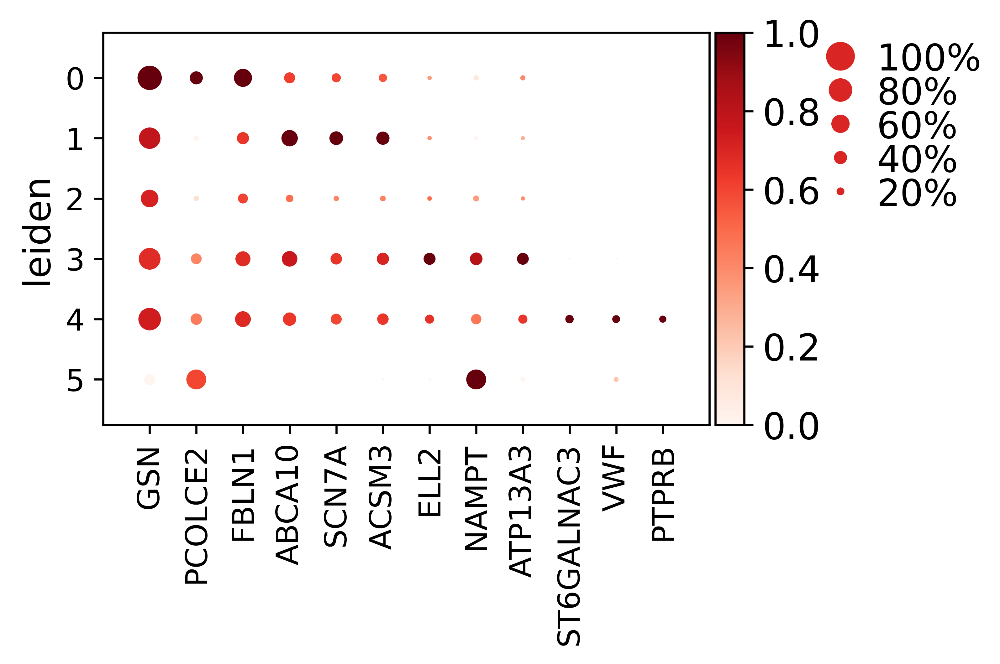

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[4.199999999999999, 0, 0.2, 0.5, 0.25])

In [12]:
sc.pl.dotplot(scgen_corrected_AT,
              makevector_topmarkers(scgen_corrected_AT, 3, ldFC_cutoff=1, pvals_adj_cutoff=10**-20),
              groupby='leiden', use_raw=True, dendrogram=False, standard_scale="var", save="")

In [13]:
scgen_corrected_AT.obs["cell_states"]=scgen_corrected_AT.obs["leiden"]
subs = {
    "0":"aFB1",
    "1":"aFB2",
    "2":"aFB3",
    "3":"aFB4",
    "4":"aFB5",
    "5":"aFB6",
     }
#rev_subs = { v:k for k,v in subs.items()}
x=[subs.get(item,item)  for item in scgen_corrected_AT.obs['cell_states']]
scgen_corrected_AT.obs['cell_states']=x
pd.value_counts(scgen_corrected_AT.obs['cell_states'])

aFB1    5619
aFB2    5492
aFB3    5420
aFB4    3906
aFB5     848
aFB6      21
Name: cell_states, dtype: int64

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:59)


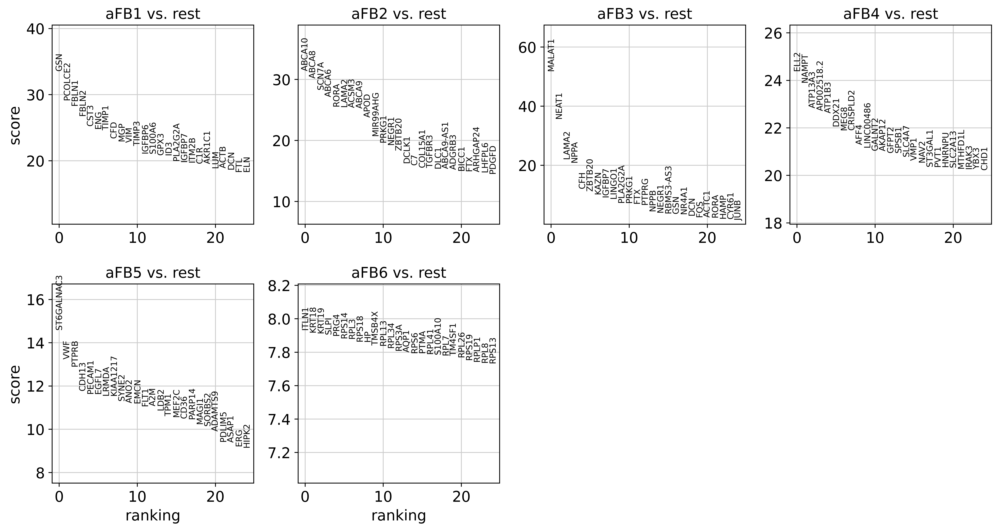

In [30]:
sc.tl.rank_genes_groups(scgen_corrected_AT, 'cell_states', method='wilcoxon') # "leiden"
sc.pl.rank_genes_groups(scgen_corrected_AT, n_genes=25, sharey=False)

In [31]:
result = scgen_corrected_AT.uns['rank_genes_groups']
groups = result['names'].dtype.names
expression_AT=pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

In [32]:
expression_AT.to_csv("/fast/AG_Huebner/huebner3/ANALYSES/20191112_cs_HH_England/scanpy/20200423/FB/scripts/figures/MARKERGENES_AT.csv")

In [14]:
scgen_corrected_AT.write(path_out + "/ALL_corrected_FB_AT_double_LEIDEN.h5ad")

... storing 'cell_states' as categorical


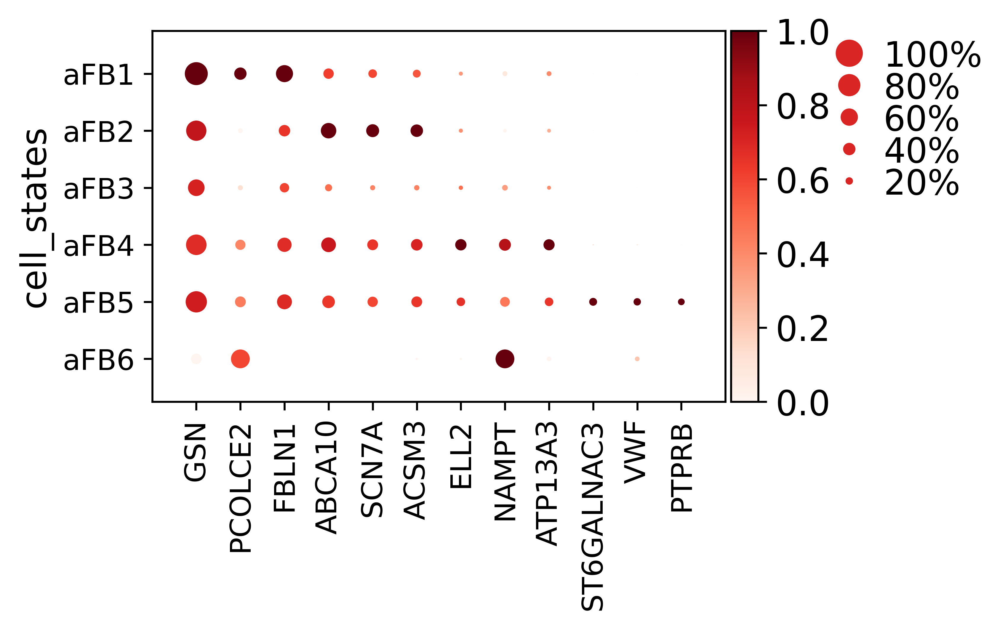

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[4.199999999999999, 0, 0.2, 0.5, 0.25])

In [34]:
sc.pl.dotplot(scgen_corrected_AT,
              makevector_topmarkers(scgen_corrected_AT, 3, ldFC_cutoff=1, pvals_adj_cutoff=10**-20),
              groupby='cell_states', use_raw=True, dendrogram=False, standard_scale="var",
             save="DOTPLOT_FB_AT.svg")

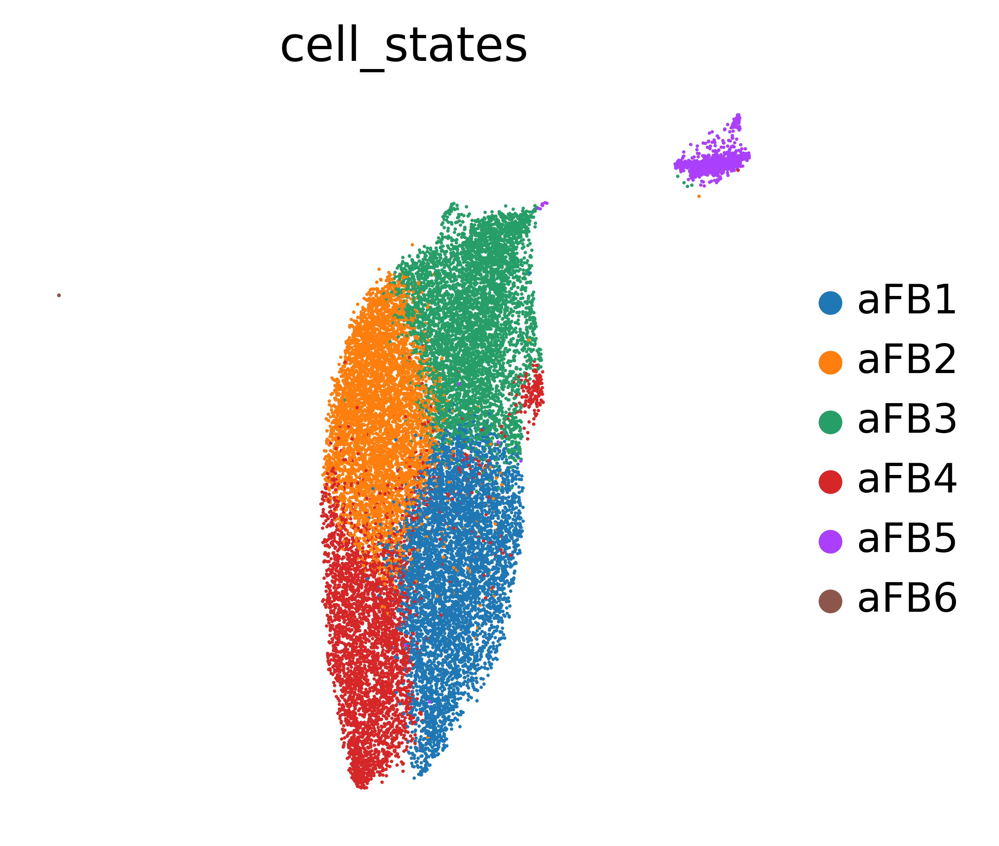

In [36]:
sc.pl.umap(scgen_corrected_AT, 
           color=['cell_states'], 
           size = 4, legend_fontsize = 12, 
          legend_loc='right margin', frameon=False,
          save="uMAP_FB_AT.svg")

### scGen normalisation of ventricular FB clustering 

In [18]:
scgen_corrected_VT=sc.read_h5ad(path_out + "/ALL_corrected_FB_V_double.h5ad")

In [19]:
sc.pp.neighbors(scgen_corrected_VT, random_state = random_state, n_neighbors=50)
sc.tl.umap(scgen_corrected_VT, min_dist = 0.4, spread = 2, random_state = random_state)
sc.tl.leiden(scgen_corrected_VT, resolution = 0.55, random_state = random_state)

computing neighbors
    using 'X_pca' with n_pcs = 50


/home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../../home/elindbe/single_cell_P3.7/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:42)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:05)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:02:14)


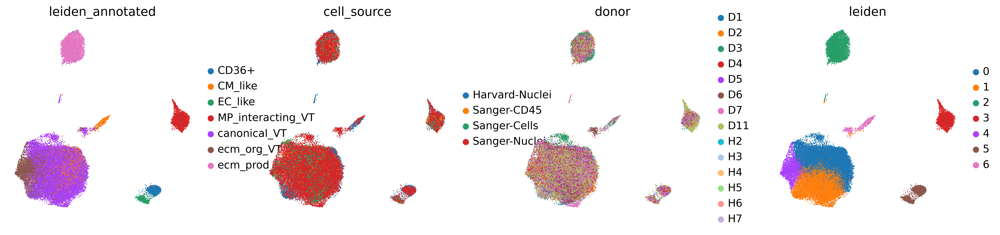

In [20]:
sc.pl.umap(scgen_corrected_VT, 
           color=['leiden_annotated', 'cell_source', 'donor', 'leiden'], 
           size = 4, legend_fontsize = 12, 
          legend_loc='right margin', frameon=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:58)


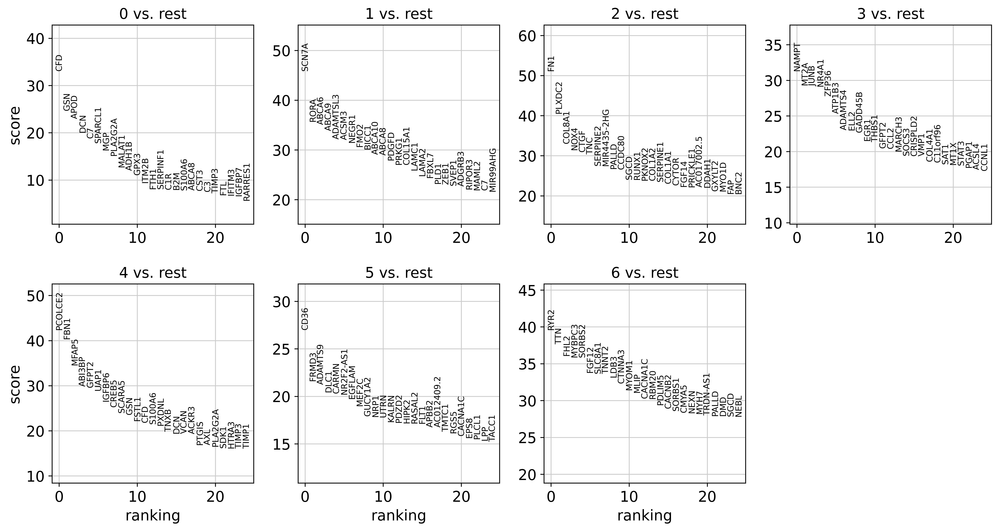

In [21]:
sc.tl.rank_genes_groups(scgen_corrected_VT, 'leiden', method='wilcoxon') # "leiden"
sc.pl.rank_genes_groups(scgen_corrected_VT, n_genes=25, sharey=False)

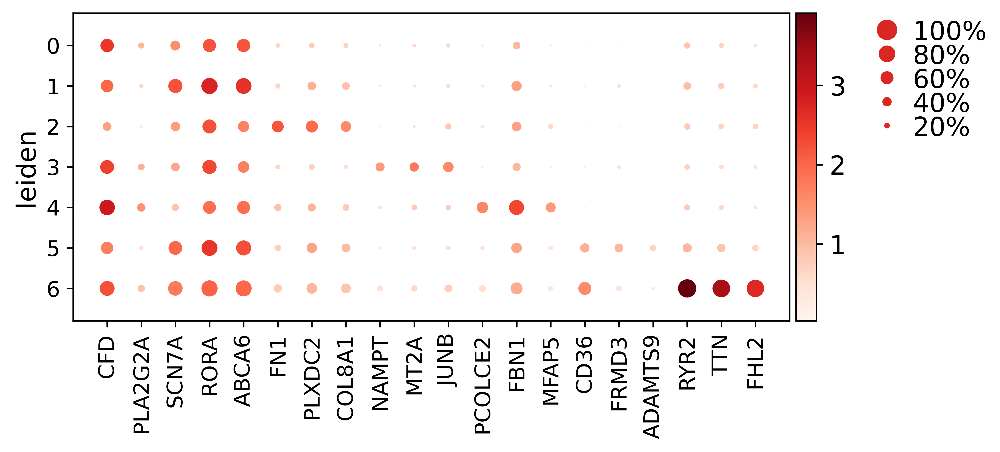

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[7.0, 0, 0.2, 0.5, 0.25])

In [22]:
sc.pl.dotplot(scgen_corrected_VT,
              makevector_topmarkers(scgen_corrected_VT, 3, ldFC_cutoff=0.8, pvals_adj_cutoff=10**-10),
              groupby='leiden', use_raw=True, dendrogram=False)

In [23]:
scgen_corrected_VT.obs["cell_states"]=scgen_corrected_VT.obs["leiden"]
subs = {
    "0":"vFB1",
    "1":"vFB1", # This cluster correlates highly with 0, so they are merged
    "2":"vFB2",
    "3":"vFB3",
    "4":"vFB4",
    "5":"vFB5",
    "6":"vFB6",
     }
x=[subs.get(item,item)  for item in scgen_corrected_VT.obs['cell_states']]
scgen_corrected_VT.obs['cell_states']=x
pd.value_counts(scgen_corrected_VT.obs['cell_states'])

vFB1    27797
vFB2     4760
vFB3     2637
vFB4     2579
vFB5     1574
vFB6      678
Name: cell_states, dtype: int64

ranking genes


... storing 'cell_states' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:02:00)


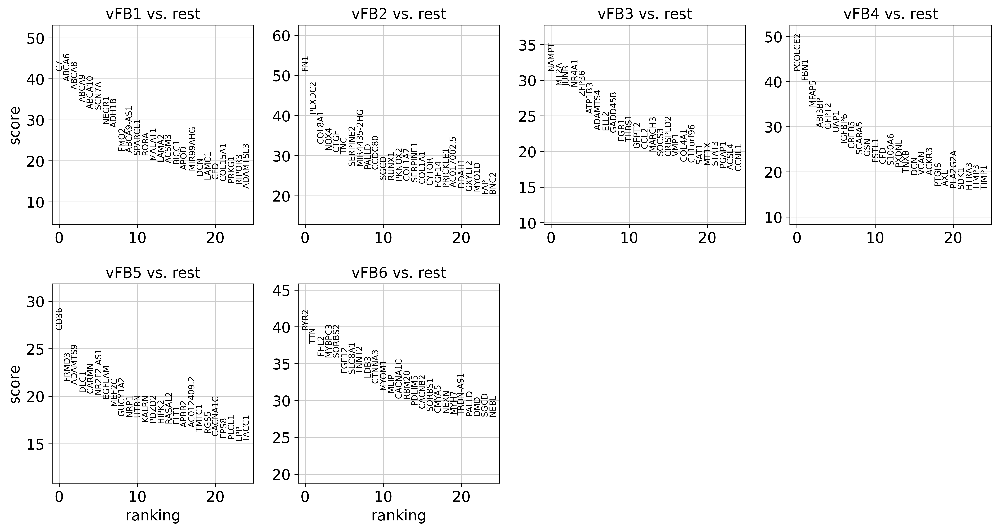

In [24]:
sc.tl.rank_genes_groups(scgen_corrected_VT, 'cell_states', method='wilcoxon') # "leiden"
sc.pl.rank_genes_groups(scgen_corrected_VT, n_genes=25, sharey=False)

In [25]:
result = scgen_corrected_VT.uns['rank_genes_groups']
groups = result['names'].dtype.names
expression_VT=pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

In [40]:
expression_VT.to_csv("/fast/AG_Huebner/huebner3/ANALYSES/20191112_cs_HH_England/scanpy/20200423/FB/scripts/figures/MARKERGENES_VT.csv")

In [26]:
#scgen_corrected_VT.write(path_out + "/ALL_corrected_FB_VT_double_LEIDEN.h5ad")

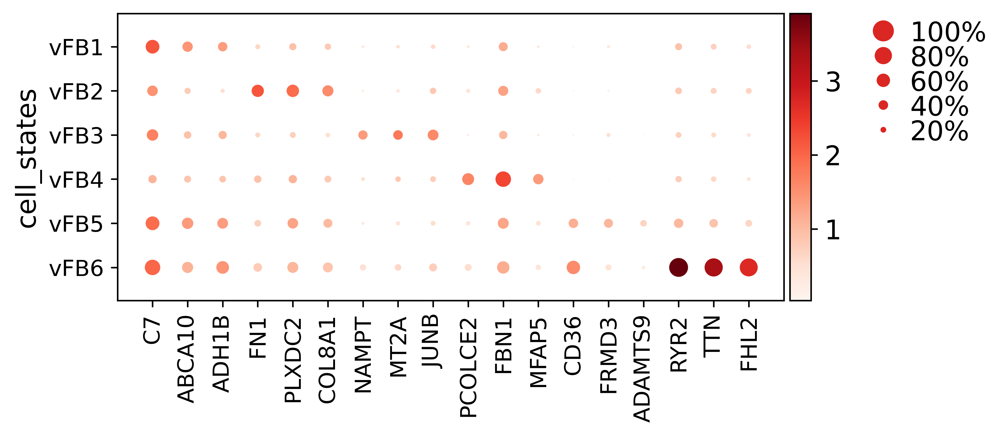

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[6.3, 0, 0.2, 0.5, 0.25])

In [38]:
sc.pl.dotplot(scgen_corrected_VT,
              makevector_topmarkers(scgen_corrected_VT, 3, ldFC_cutoff=1, pvals_adj_cutoff=10**-10),
              groupby='cell_states', use_raw=True, dendrogram=False,
             save="DOTPLOT_FB_V.svg")

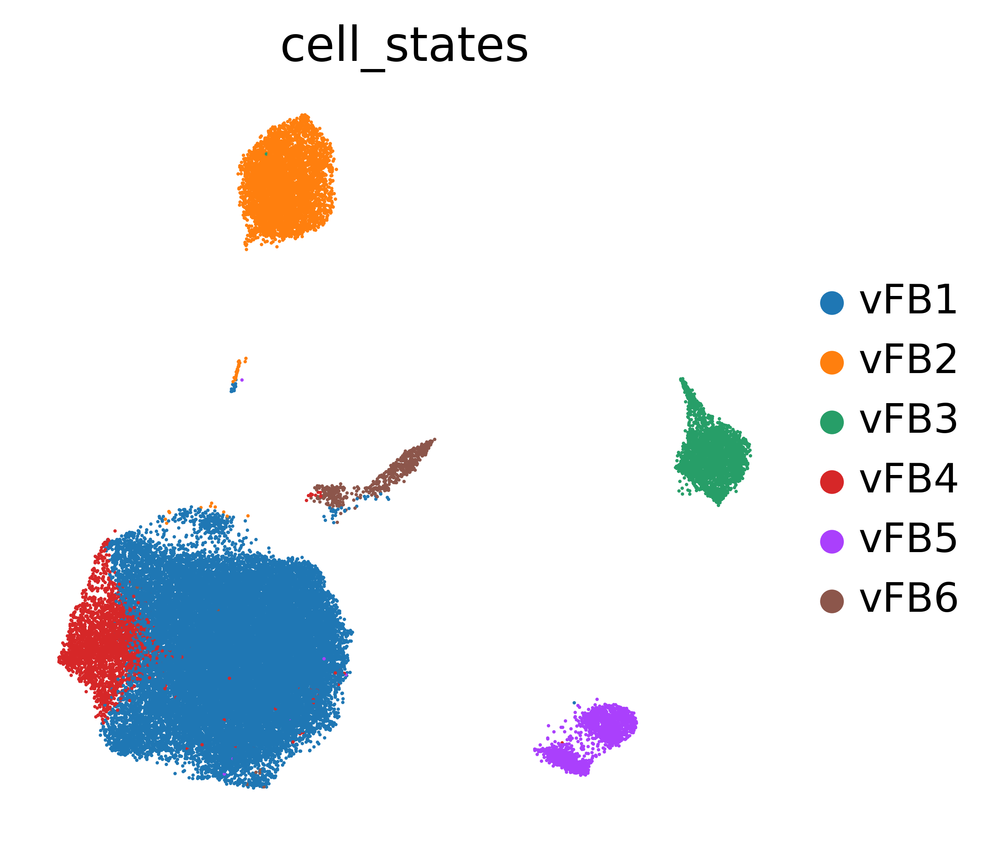

In [39]:
sc.pl.umap(scgen_corrected_VT, 
           color=['cell_states'], 
           size = 4, legend_fontsize = 12, 
          legend_loc='right margin', frameon=False,
          save="uMAP_FB_V.svg")

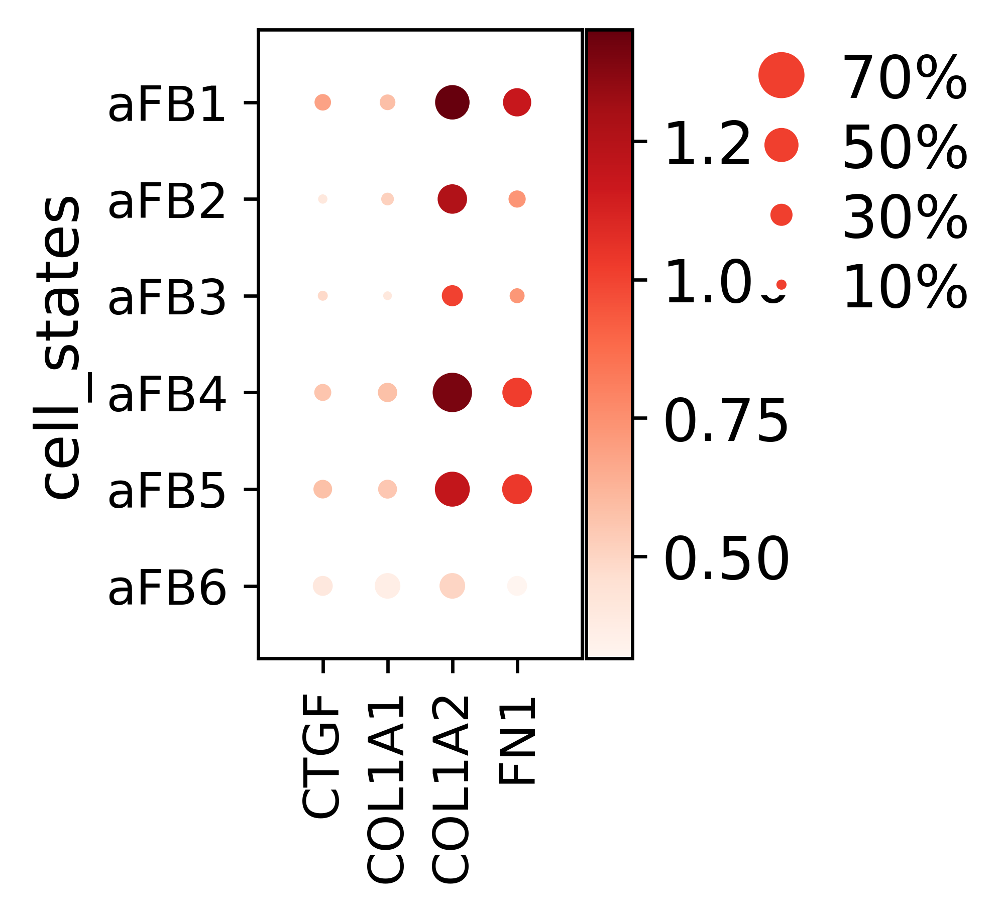

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[1.4, 0, 0.2, 0.5, 0.25])

In [26]:
sc.pl.dotplot(scgen_corrected_AT,
              ['CTGF', "COL1A1", "COL1A2", "FN1"],
              groupby='cell_states', use_raw=True, dendrogram=False)

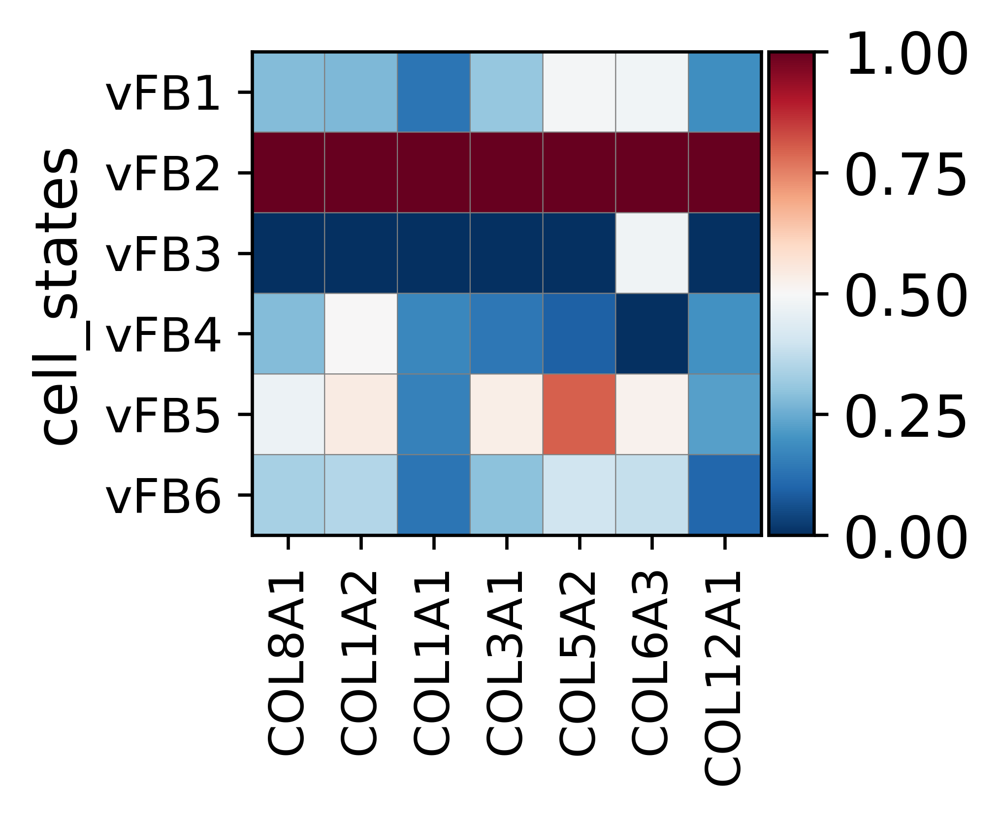

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[2.24, 0, 0.2])

In [41]:
sc.pl.matrixplot(scgen_corrected_VT,
              ['COL8A1', 'COL1A2', 'COL1A1', 'COL3A1', 'COL5A2', 'COL6A3', 'COL12A1'],
              groupby='cell_states', standard_scale='var')

## Differences in ECM producing population in AT and VT

Here we focus on DEgene analysis of the atrial ECM producing and organising FB population in the human heart. 

In [42]:
ecm_p=(scgen_corrected_VT[scgen_corrected_VT.obs['cell_states'].isin(['vFB2'])]).concatenate(scgen_corrected_AT[scgen_corrected_AT.obs['cell_states'].isin(['aFB2'])])

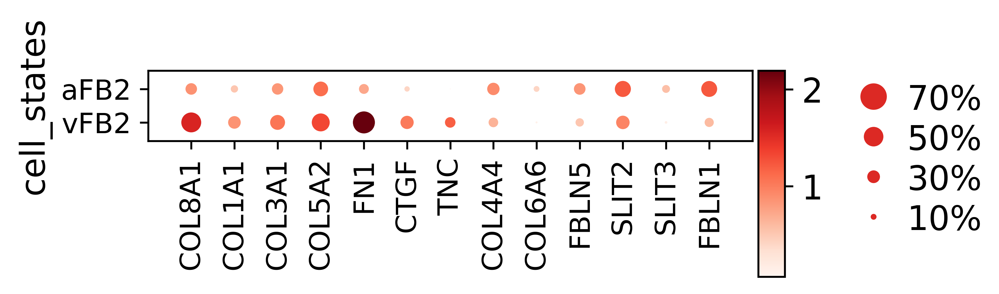

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[4.55, 0, 0.2, 0.5, 0.25])

In [106]:
sc.pl.dotplot(ecm_p,
              ['COL8A1', 'COL1A1', 'COL3A1', 'COL5A2', 'FN1', "CTGF",
              "COL4A4", "COL6A6", 'FBLN5', 'SLIT2', 'SLIT3', 'FBLN1'],
              groupby='cell_states')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:22)


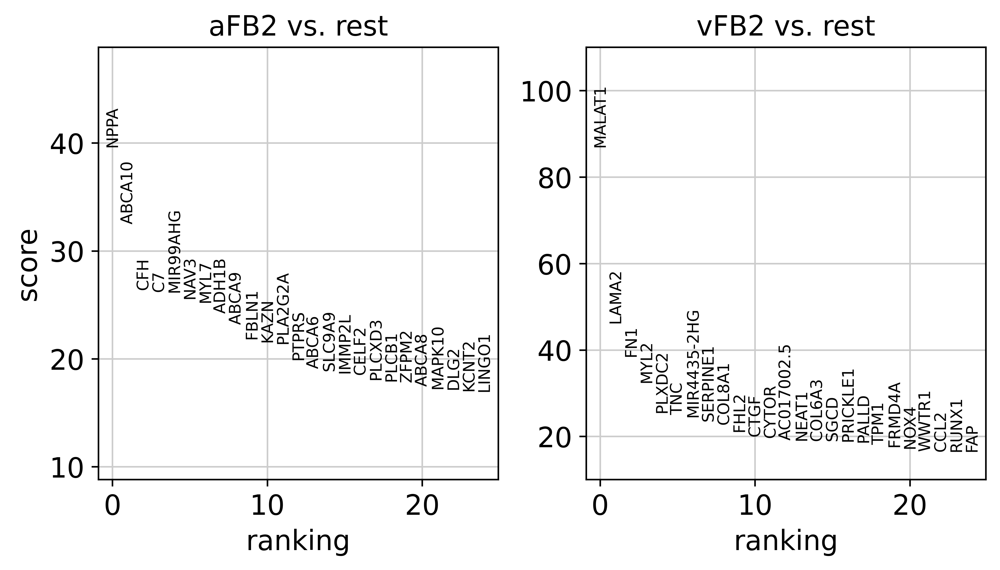

In [46]:
sc.tl.rank_genes_groups(ecm_p, 'cell_states', method='wilcoxon') # "leiden"
sc.pl.rank_genes_groups(ecm_p, n_genes=25, sharey=False)

In [91]:
expression.to_csv("/fast/AG_Huebner/huebner3/ANALYSES/20191112_cs_HH_England/scanpy/20200423/FB/scripts/figures/ecmp_comp_MARKERGENES.csv")

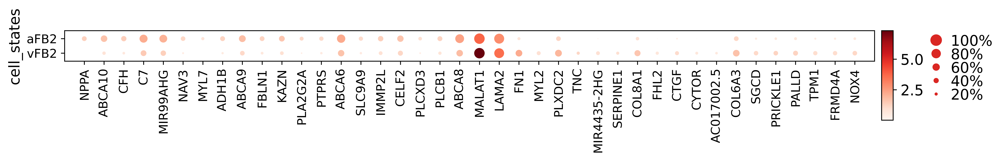

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[14.0, 0, 0.2, 0.5, 0.25])

In [30]:
sc.pl.dotplot(ecm_p,
              makevector_topmarkers(ecm_p, 20, ldFC_cutoff=0.8, pvals_adj_cutoff=10**-10),
              groupby='cell_states', use_raw=True, dendrogram=False)

In [47]:
#result = ecm_p.uns['rank_genes_groups']
#groups = result['names'].dtype.names
#expression=pd.DataFrame(
#    {group + '_' + key[:1]: result[key][group]
#    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

In [96]:
ecm_o=(scgen_corrected_VT[scgen_corrected_VT.obs['cell_states'].isin(['vFB4'])]).concatenate(scgen_corrected_AT[scgen_corrected_AT.obs['cell_states'].isin(['aFB1'])])

ranking genes


... storing 'cell_states' as categorical
... storing 'cell_type' as categorical
... storing 'leiden' as categorical
... storing 'leiden_annotated' as categorical
... storing 'region' as categorical
... storing 'region_atv' as categorical
... storing 'region_lr' as categorical
... storing 'sample' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:19)


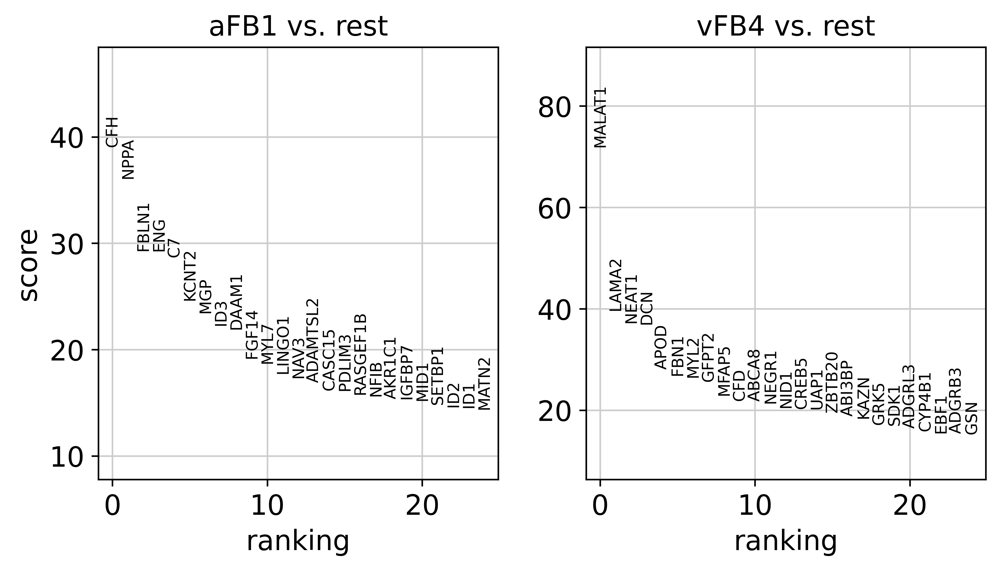

In [97]:
sc.tl.rank_genes_groups(ecm_o, 'cell_states', method='wilcoxon') # "leiden"
sc.pl.rank_genes_groups(ecm_o, n_genes=25, sharey=False)

In [98]:
result = ecm_o.uns['rank_genes_groups']
groups = result['names'].dtype.names
expression=pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

In [99]:
expression.to_csv("/fast/AG_Huebner/huebner3/ANALYSES/20191112_cs_HH_England/scanpy/20200423/FB/scripts/figures/ecmo_comp_MARKERGENES.csv")

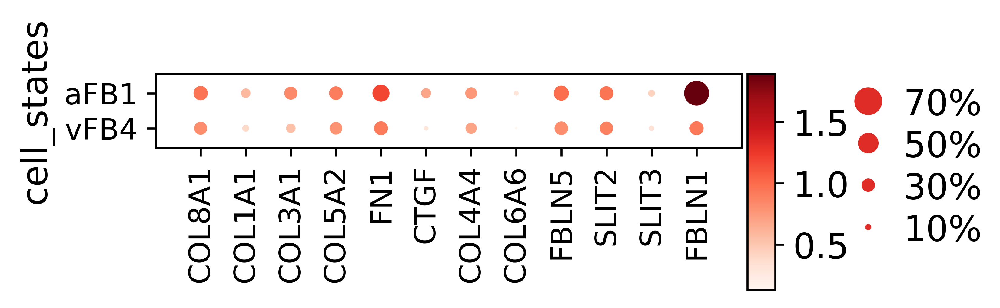

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[4.199999999999999, 0, 0.2, 0.5, 0.25])

In [114]:
sc.pl.dotplot(ecm_o,
              ['COL8A1', 'COL1A1', 'COL3A1', 'COL5A2', 'FN1', "CTGF",
              "COL4A4", "COL6A6", 'FBLN5', 'SLIT2', 'SLIT3', 'FBLN1'],
              groupby='cell_states')

In [107]:
ecm_all=ecm_o.concatenate(ecm_p)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:46)


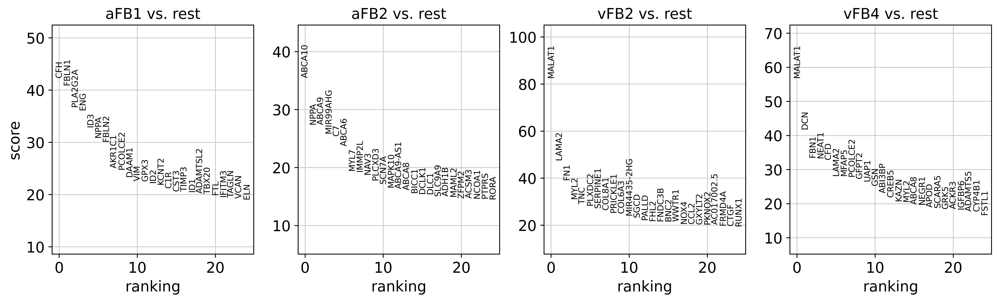

In [125]:
sc.tl.rank_genes_groups(ecm_all, 'cell_states', method='wilcoxon', n_genes=200) # "leiden"
sc.pl.rank_genes_groups(ecm_all, n_genes=25, sharey=False)

In [126]:
result = ecm_all.uns['rank_genes_groups']
groups = result['names'].dtype.names
expression=pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

In [127]:
expression.to_csv("/fast/AG_Huebner/huebner3/ANALYSES/20191112_cs_HH_England/scanpy/20200423/FB/scripts/figures/ecmall_comp_MARKERGENES.csv")

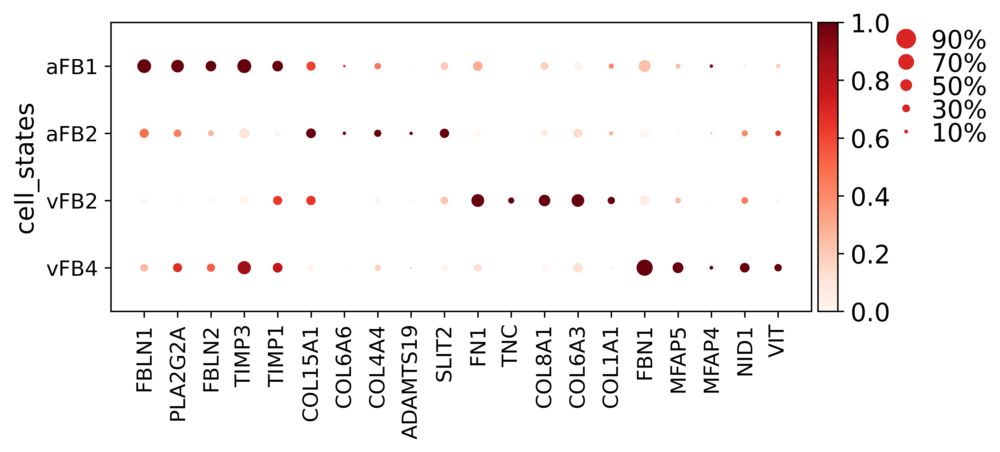

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[7.05, 0, 0.2, 0.5, 0.25])

In [134]:
sc.pl.dotplot(ecm_all,
              ['FBLN1', 'PLA2G2A', 'FBLN2', 'TIMP3', 'TIMP1', 
              "COL15A1", "COL6A6", 'COL4A4', 'ADAMTS19', 'SLIT2', 
              "FN1", "TNC", "COL8A1", "COL6A3", "COL1A1",
              "FBN1", "MFAP5", "MFAP4", "NID1", "VIT"],
              groupby='cell_states', standard_scale="var", figsize=[8,3])

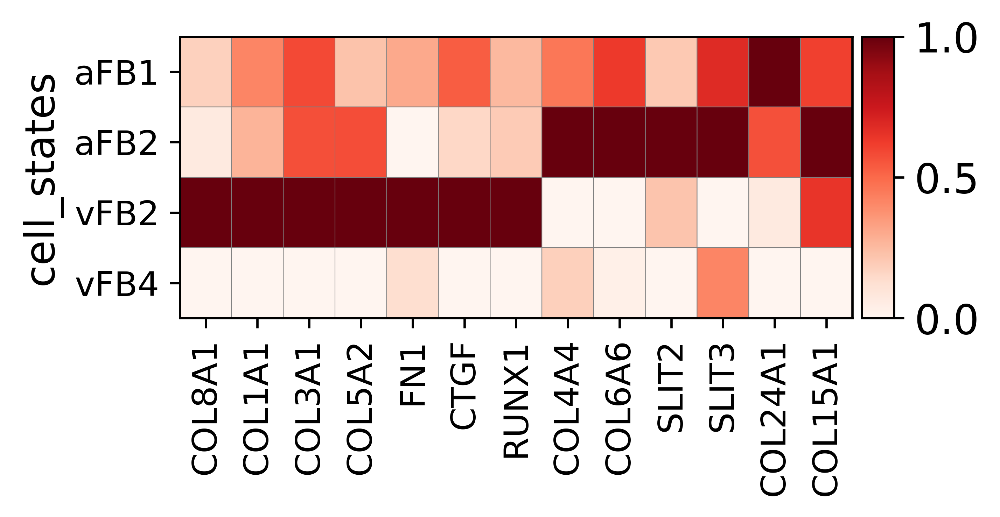

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[4.16, 0, 0.2])

In [115]:
sc.pl.matrixplot(ecm_all,
              ['COL8A1', 'COL1A1', 'COL3A1', 'COL5A2', 'FN1', "CTGF", "RUNX1",
              "COL4A4", "COL6A6", 'SLIT2', 'SLIT3',
              "COL24A1", "COL15A1"],
              groupby='cell_states', standard_scale="var", cmap="Reds")